In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OrdinalEncoder
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
import requests

# Data Import

In [2]:
url = 'https://archive.ics.uci.edu/static/public/222/data.csv'

request = requests.get(url)
with open("../data/raw/bank-full.csv", 'wb') as f:
        f.write(request.content)

# Global Config

In [3]:
pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.3f}'.format
random_state = 522

### Pre-Exploration

In [4]:
bank = pd.read_csv('../data/raw/bank-full.csv', sep=',')

In [5]:
bank.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day_of_week', 'month', 'duration', 'campaign',
       'pdays', 'previous', 'poutcome', 'y'],
      dtype='object')

In [6]:
bank.shape

(45211, 17)

In [7]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN,no
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN,no
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN,no


In [8]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  object
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  object
 7   loan         45211 non-null  object
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [9]:
bank.y.value_counts()/len(bank)

y
no    0.883
yes   0.117
Name: count, dtype: float64

Pay attention that the target is **class-imbalanced**

# Train Test Split

In [ ]:
bank_train, bank_test = train_test_split(bank,
                                         test_size=0.2,
                                         random_state=random_state,
                                         stratify=bank.y
                                        )

In [11]:
bank_train.y.value_counts()/len(bank_train)

y
no    0.883
yes   0.117
Name: count, dtype: float64

In [12]:
X_train, y_train = bank_train.drop(columns=["y"]), bank_train["y"]
X_test, y_test = bank_test.drop(columns=["y"]), bank_test["y"]

Via stratified split, we managed to keep the distribution of the label in the original dataset.

# EDA

In [13]:
for i in list(bank_train.columns):
    print(f"{i:<10}->  {bank_train[i].nunique():<5} unique values")

age       ->  77    unique values
job       ->  11    unique values
marital   ->  3     unique values
education ->  3     unique values
default   ->  2     unique values
balance   ->  6601  unique values
housing   ->  2     unique values
loan      ->  2     unique values
contact   ->  2     unique values
day_of_week->  31    unique values
month     ->  12    unique values
duration  ->  1506  unique values
campaign  ->  47    unique values
pdays     ->  536   unique values
previous  ->  40    unique values
poutcome  ->  3     unique values
y         ->  2     unique values


In [14]:
bank_int = list(bank_train.select_dtypes(include = ['int64']).columns)
bank_str = list(bank_train.select_dtypes(include = ['object']).columns)
# bank_str.remove("y")
bank_categorical = bank_str+['day']

## Data Viz

In [36]:
import altair as alt

alt.data_transformers.disable_max_rows()

charts = []

for i, var in enumerate(bank_categorical):
    if i == 9:  
        break

    num_rows = len(bank_train[var].unique())

    chart = alt.Chart(bank_train).mark_bar(stroke=None).encode(
        x=alt.X('count()', title='Count'),
        y=alt.Y('y:N', title=None),
        color=alt.Color('y:N', scale=alt.Scale(range=['#3C6682', '#45A778'])),
        row=alt.Row(f'{var}:N')
    ).properties(
        width=200,
        height=200 / num_rows,
        title=f'Grouped Bar Plot for {var}',
        spacing=0
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False).configure_header(
    labelAngle=0,
    labelAlign='left'
)

final_chart


alt.ConcatChart(...)

In [16]:
bank_continuous = bank_train[bank_int]

charts = []

for i, column in enumerate(bank_continuous.columns):
    hist_chart = alt.Chart(bank_train).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

alt.ConcatChart(...)

In [34]:
bank_log = ['balance', 'duration', 'campaign', 'pdays', 'previous']
charts = []

for i, column in enumerate(bank_log):
    hist_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

C:\Users\Marcony1\AppData\Local\Temp\ipykernel_34420\2615118493.py:5: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  hist_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).mark_bar(opacity=0.7, color='steelblue').encode(
c:\Users\Marcony1\miniconda3\envs\bank_marketing_env\lib\site-packages\pandas\core\algorithms.py:1814: RuntimeWarning: invalid value encountered in log1p
  return lib.map_infer(values, mapper, convert=convert)
c:\Users\Marcony1\miniconda3\envs\bank_marketing_env\lib\site-packages\pandas\core\algorithms.py:1814: RuntimeWarning: divide by zero encountered in log1p
  return lib.map_infer(values, mapper, convert=convert)
C:\Users\Marcony1\AppData\Local\Temp\ipykernel_34420\2615118493.py:10: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  kde_chart = alt.Chart(bank_train[bank_log].applymap(np.log1p)).transform_density(
c:\Users\Marcony1\miniconda3\envs\bank_marketing_env\lib\site-packages\pand

alt.ConcatChart(...)

# Preprocessing

In this section, we are defining lists with the names of the features according to their type. 

In [18]:
numeric_features = bank.select_dtypes('number').columns.tolist()
categorical_features = ['job', 'marital', 'contact', 'month', 'poutcome']
ordinal_features = ['education']
binary_features = ['default', 'housing', 'loan']
drop_features = []
target = "y"

Then, we define all the transformations that have to be applied to the different columns. We define the order of the education levels as they belong to an ordinal variable and we create pipelines to manage nulls before each transformation. All of the transformations impute the most frequent value except for the numeric transformer, which imputes the median value.

In [19]:
education_levels = ['tertiary', 'secondary', 'primary']
ordinal_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                    OrdinalEncoder(categories=[education_levels], dtype=int))

numeric_transformer = make_pipeline(SimpleImputer(strategy="median"), StandardScaler())

binary_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                    OneHotEncoder(dtype=int, drop='if_binary'))

categorical_transformer = make_pipeline(SimpleImputer(strategy="most_frequent"),
                                        OneHotEncoder(handle_unknown="ignore", sparse_output=False))

Finally, we create a column transformer named preprocessor.

In [20]:
preprocessor = ColumnTransformer(
    transformers=[
        ('numeric', numeric_transformer, numeric_features),
        ('ordinal', ordinal_transformer, ordinal_features),
        ('binary', binary_transformer, binary_features),
        ('categorical', categorical_transformer, categorical_features),
        ('drop', 'passthrough', drop_features)
    ])

### Fitting and transforming X_train

In [21]:
transformed_train = preprocessor.fit_transform(X_train)
column_names = (
    numeric_features +
    ordinal_features +
    preprocessor.named_transformers_['binary'].named_steps['onehotencoder'].get_feature_names_out().tolist() +
    preprocessor.named_transformers_['categorical'].named_steps['onehotencoder'].get_feature_names_out().tolist() 
    )

X_train_trans = pd.DataFrame(transformed_train, columns=column_names)

In [22]:
X_train_trans.head(5)

,age,balance,day_of_week,duration,campaign,pdays,previous,education,x0_yes,x1_yes,x2_yes,x0_admin.,x0_blue-collar,x0_entrepreneur,x0_housemaid,x0_management,x0_retired,x0_self-employed,x0_services,x0_student,x0_technician,x0_unemployed,x1_divorced,x1_married,x1_single,x2_cellular,x2_telephone,x3_apr,x3_aug,x3_dec,x3_feb,x3_jan,x3_jul,x3_jun,x3_mar,x3_may,x3_nov,x3_oct,x3_sep,x4_failure,x4_other,x4_success
0,-0.463,-0.413,0.627,-0.733,-0.564,-0.411,-0.243,1.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
1,1.612,-0.072,-1.418,-0.679,0.072,-0.411,-0.243,1.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
2,-0.086,-0.408,-1.418,-0.510,-0.564,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
3,-0.369,-0.445,-1.178,-0.421,-0.564,-0.271,4.767,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000
4,0.197,-0.292,1.228,-0.283,-0.564,-0.411,-0.243,1.000,0.000,1.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000


In [23]:
y_train.head(5)

4868     no
29723    no
8911     no
34737    no
5657     no
Name: y, dtype: object

### Transforming X_test

In [24]:
transformed_test = preprocessor.transform(X_test)
column_names = (
    numeric_features +
    ordinal_features +
    preprocessor.named_transformers_['binary'].named_steps['onehotencoder'].get_feature_names_out().tolist() +
    preprocessor.named_transformers_['categorical'].named_steps['onehotencoder'].get_feature_names_out().tolist() 
    )

X_test_trans = pd.DataFrame(transformed_test, columns=column_names)

In [25]:
X_test_trans.head(5)

,age,balance,day_of_week,duration,campaign,pdays,previous,education,x0_yes,x1_yes,x2_yes,x0_admin.,x0_blue-collar,x0_entrepreneur,x0_housemaid,x0_management,x0_retired,x0_self-employed,x0_services,x0_student,x0_technician,x0_unemployed,x1_divorced,x1_married,x1_single,x2_cellular,x2_telephone,x3_apr,x3_aug,x3_dec,x3_feb,x3_jan,x3_jul,x3_jun,x3_mar,x3_may,x3_nov,x3_oct,x3_sep,x4_failure,x4_other,x4_success
0,1.235,-0.278,-1.178,-0.241,-0.246,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
1,0.480,-0.189,0.747,-0.471,0.390,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
2,0.291,0.351,1.709,-0.483,-0.246,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000
3,1.517,-0.445,-0.215,-0.514,0.708,-0.411,-0.243,1.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,1.000,0.000,0.000
4,1.706,-0.110,-1.298,1.578,-0.564,-0.411,-0.243,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.000,0.000,1.000,0.000,0.000


In [26]:
y_test.head(5)

685       no
16193     no
17989     no
38058     no
24132    yes
Name: y, dtype: object

# Modeling

In [27]:
...

Ellipsis

In [28]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN,no
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN,no
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN,no


In [29]:
for i in ['y','loan','housing','default']:
    bank[i] = bank[i].map({'yes':1,'no':0})

In [30]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,0,2143,1,0,NaN,5,may,261,1,-1,0,NaN,0
1,44,technician,single,secondary,0,29,1,0,NaN,5,may,151,1,-1,0,NaN,0
2,33,entrepreneur,married,secondary,0,2,1,1,NaN,5,may,76,1,-1,0,NaN,0
3,47,blue-collar,married,NaN,0,1506,1,0,NaN,5,may,92,1,-1,0,NaN,0
4,33,NaN,single,NaN,0,1,0,0,NaN,5,may,198,1,-1,0,NaN,0


In [31]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  object
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  object
 7   loan         45211 non-null  object
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [126]:
bank.poutcome.isna().sum()

36959

In [129]:
bank.poutcome.value_counts()

poutcome
unknown    36959
failure     4901
other       1840
success     1511
Name: count, dtype: int64

Based on the data column description, null values should be assign to 'unkown'.

In [128]:
bank.fillna('unknown', inplace=True)

In [130]:
bank.poutcome.value_counts()

poutcome
unknown    36959
failure     4901
other       1840
success     1511
Name: count, dtype: int64

In [131]:
# one-hot encoding, solved for the multicollinearity

columns = bank.select_dtypes(include=[object]).columns
bank_dummies = pd.concat([bank, pd.get_dummies(bank[columns], drop_first = True)], axis=1)
bank_dummies = bank_dummies.drop(['job', 'marital', 'education', 'contact', 'month', 'poutcome'], axis=1)

In [133]:
bank_dummies.columns

Index(['age', 'default', 'balance', 'housing', 'loan', 'day_of_week',
       'duration', 'campaign', 'pdays', 'previous', 'y', 'job_blue-collar',
       'job_entrepreneur', 'job_housemaid', 'job_management', 'job_retired',
       'job_self-employed', 'job_services', 'job_student', 'job_technician',
       'job_unemployed', 'job_unknown', 'marital_married', 'marital_single',
       'education_secondary', 'education_tertiary', 'education_unknown',
       'contact_telephone', 'contact_unknown', 'month_aug', 'month_dec',
       'month_feb', 'month_jan', 'month_jul', 'month_jun', 'month_mar',
       'month_may', 'month_nov', 'month_oct', 'month_sep', 'poutcome_other',
       'poutcome_success', 'poutcome_unknown'],
      dtype='object')

Correlation Matrix 



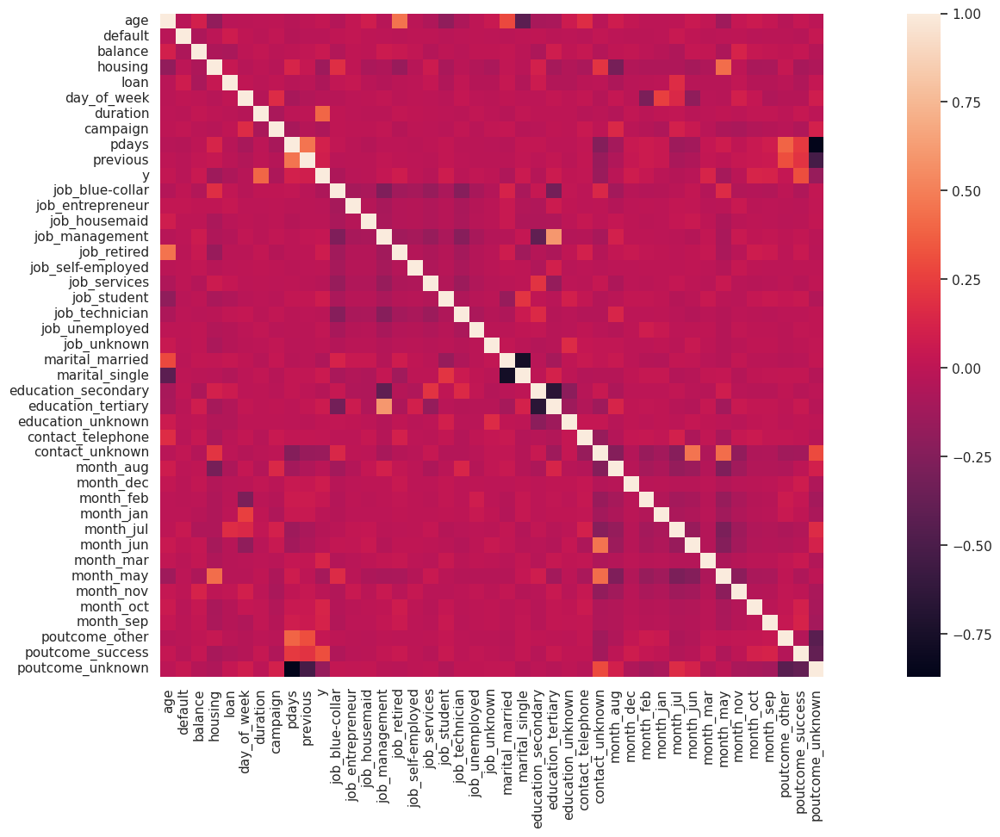

In [134]:
#Heat map
print("Correlation Matrix","\n")    
correlation=bank_dummies.corr(method="pearson")
plt.figure(figsize=(25,10))
sns.heatmap(correlation,vmax=1,square=True,annot=False)
plt.show()

In [ ]:
# data set with one - hot encoding, for those algorithm which is sensitive to the catergorical variables like LogisticR...
# Choose either to use, will use 80% to do stratified cross validation, example found in Modeling section below
y_onehot = bank_dummies['y'].values
X_onehot = bank_dummies.drop(columns = ['y'])
X_train_o, X_test_o, y_train_o, y_test_o = train_test_split(X_onehot, y_onehot
                                                            , test_size=0.2
                                                            , random_state=random_state
                                                            , stratify=y_onehot
                                                           )
# check whether stratified
print(np.unique(y_train_o, return_counts=True),"\n",np.unique(y_test_o, return_counts=True))

(array([0, 1], dtype=int64), array([31937,  4231], dtype=int64)) 
 (array([0, 1], dtype=int64), array([7985, 1058], dtype=int64))


In [136]:
resample_list = ['random_over_sample','SMOTE','ADASYN','BorderlineSMOTE','KMeansSMOTE', 'ClusterCentroids','random_under_sample']

def re_sample(X, y, func=None, random_state=2021):
    if func == None:
        return
    
    elif func == 'random_over_sample':
        ros = RandomOverSampler(random_state=random_state)
        X_resampled, y_resampled = ros.fit_resample(X, y)
    
    elif func == 'SMOTE':
        X_resampled, y_resampled = SMOTE().fit_resample(X, y)
    
    elif func == 'ADASYN':
        X_resampled, y_resampled = ADASYN().fit_resample(X, y)
        
    elif func == 'BorderlineSMOTE':
        X_resampled, y_resampled = BorderlineSMOTE().fit_resample(X, y)
        
    elif func == 'KMeansSMOTE':
        X_resampled, y_resampled = KMeansSMOTE(cluster_balance_threshold=0.005).fit_resample(X, y) # https://arxiv.org/pdf/1711.00837.pdf
    
    elif func == 'ClusterCentroids':
        X_resampled, y_resampled = ClusterCentroids().fit_resample(X, y)
        
    elif func == 'random_under_sample':
        X_resampled, y_resampled = RandomUnderSampler().fit_resample(X, y) 
    
    else:
        return

    return X_resampled, y_resampled

#todo: Combination of over- and under-sampling

In [191]:
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder, MinMaxScaler, StandardScaler
from sklearn.feature_selection import SelectKBest, chi2, VarianceThreshold
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold,GridSearchCV, cross_val_score, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, auc,roc_curve,accuracy_score, f1_score, roc_auc_score, log_loss,cohen_kappa_score, classification_report, recall_score, precision_score, matthews_corrcoef,make_scorer
from sklearn.utils import resample
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

from sklearn.naive_bayes import GaussianNB,ComplementNB, MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier, VotingClassifier, GradientBoostingClassifier, IsolationForest
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn import metrics

from imblearn.over_sampling import RandomOverSampler,SMOTE, ADASYN, BorderlineSMOTE, KMeansSMOTE
from imblearn.under_sampling import ClusterCentroids,RandomUnderSampler
from imblearn.ensemble import BalancedBaggingClassifier, BalancedRandomForestClassifier, EasyEnsembleClassifier

from sklearn.pipeline import Pipeline, make_pipeline

In [138]:
def compute_and_plot_roc_curve(model, testing_x, testing_y,name):
    predict_prob = model.predict_proba(testing_x)
    fpr, tpr, threshold = metrics.roc_curve(testing_y, predict_prob[:,1])
    roc_auc = metrics.auc(fpr, tpr)
    plt.figure(figsize=(10,10),facecolor="white")
    plt.title('Receiver Operating Characteristic')
    plt.plot(fpr, tpr, 'b', label = '{} : {:0.3f}'.format(name,roc_auc))
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
    
    return fpr, tpr, roc_auc

In [171]:
def model_report(model, testing_x, testing_y, name, customerized_threshold=False, threshold=0.5, plot_confusion_matrix = True) :

    predictions  = model.predict(testing_x)
    predictions_prob = model.predict_proba(testing_x)
    
    if customerized_threshold:
        predictions = []
        for pred in predictions_prob[:,1]:  
            predictions.append(1) if pred > threshold else predictions.append(0) 
    recallscore  = recall_score(testing_y,predictions)
    precision    = precision_score(testing_y,predictions)
    roc_auc      = roc_auc_score(testing_y,predictions_prob[:, 1])
    f1score      = f1_score(testing_y,predictions) 
    kappa_metric = cohen_kappa_score(testing_y,predictions)
    MCC          = matthews_corrcoef(testing_y, predictions)
    
    
    # classification_report
    print(classification_report(testing_y,predictions))
    
    # customered_confusion_matrix
    if plot_confusion_matrix:   
        fact = testing_y
        classes = list(set(fact))
        classes.sort()
        confusion = confusion_matrix(predictions, testing_y)
        plt.figure(figsize=(5,5), dpi=150)
        plt.imshow(confusion, cmap=plt.cm.Blues)
    #     plt.imshow(confusion, cmap="viridis")
        indices = range(len(confusion))
        plt.xticks(indices, classes,fontsize=10)
        plt.yticks(indices, classes,fontsize=10)
        plt.colorbar()
        plt.xlabel('Predictions',fontsize=10)
        plt.ylabel('Ground Turth',fontsize=10)
        for first_index in range(len(confusion)):
            for second_index in range(len(confusion[first_index])):
                plt.text(first_index, second_index, confusion[first_index][second_index],va = 'center',ha = 'center',c='darkorange',fontsize=10)
        plt.grid(False)
    
    df = pd.DataFrame({"Model"           : [name],
                       "Recall_score"    : [recallscore],
                       "Precision"       : [precision],
                       "f1_score"        : [f1score],
                       "Area_under_curve": [roc_auc],
                       "Kappa_metric"    : [kappa_metric],
                       "MCC"             : [MCC]
                      })
    return df

In [153]:
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=2021)

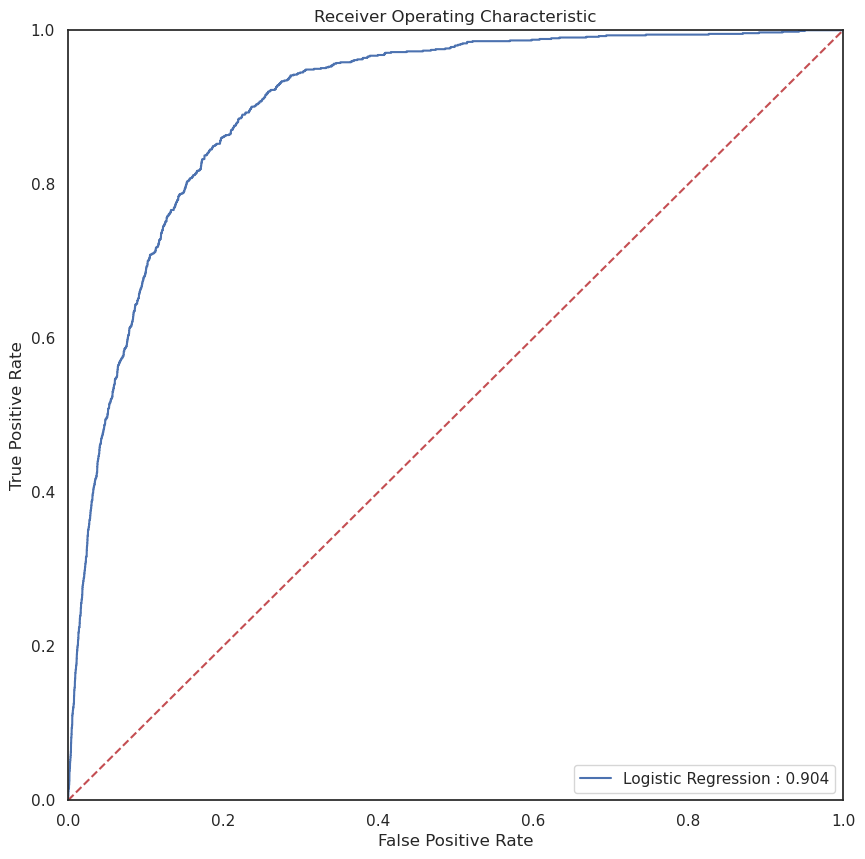

              precision    recall  f1-score   support

           0       0.97      0.84      0.90      7985
           1       0.40      0.81      0.54      1058

    accuracy                           0.84      9043
   macro avg       0.69      0.82      0.72      9043
weighted avg       0.90      0.84      0.86      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve,Kappa_metric,MCC
0,Logistic Regression,0.811,0.400,0.535,0.904,0.449,0.491


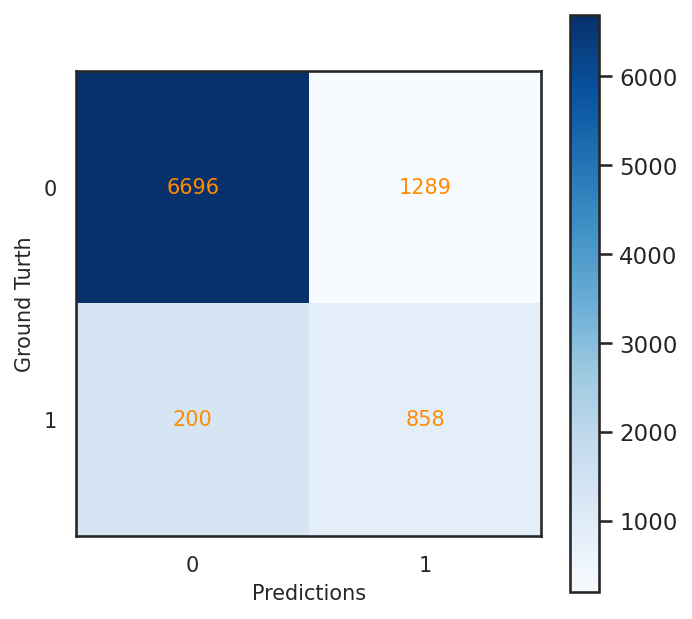

In [177]:
# Logistic Regression on the test set
RANDOM_STATE = 2023

seed = np.random.seed(RANDOM_STATE)

# Use the selected hyperparameters
lr = LogisticRegression(C = 1,
                        max_iter = 5000,
                        random_state = RANDOM_STATE)



min_max_scaler = MinMaxScaler()

# Feature selection: remove features with low variance (42 -> 40 features)
sel = VarianceThreshold(threshold=0.01)
sel_var=sel.fit_transform(X_train_o)
train_x_lv = X_train_o[X_train_o.columns[sel.get_support(indices=True)]]
test_x_lv = X_test_o[train_x_lv.columns]
#print(train_x_lv.shape)

# Feature selection: remove one of the highly correlated features > 0.8 (40 -> 39 features)
correlation_train = train_x_lv.corr(method="pearson")
columns = np.full((correlation_train.shape[0],), True, dtype=bool)
for i in range(correlation_train.shape[0]):
    for j in range(i+1, correlation_train.shape[0]):
        if abs(correlation_train.iloc[i,j]) >= 0.8:
            if columns[j]:
                columns[j] = False
selected_columns = train_x_lv.columns[columns]
train_x_cf = train_x_lv[selected_columns]
test_x_cf = test_x_lv[selected_columns]
#print(train_x_cf.shape)

# Undersampling
train_x_rs, train_y_rs = re_sample(train_x_cf, y_train_o, func='random_under_sample', random_state=RANDOM_STATE)


X_tr,  y_tr = train_x_rs, train_y_rs
X_t,  y_t = test_x_cf, y_test_o
# Train the model
lr.fit(X_tr,  y_tr)

fpr_lr, tpr_lr, auc_lr= compute_and_plot_roc_curve(lr,X_t,  y_t, "Logistic Regression")

model_lr = model_report(lr, X_t, y_t, "Logistic Regression")
model_lr

# knn

In [183]:
weights= 'distance'
n_neighbors= 9
func= 'SMOTE'

knn = KNeighborsClassifier(n_neighbors=n_neighbors, weights=weights, n_jobs=-1)

X_train_scaled = pd.DataFrame(scaler.fit_transform(X_train_o),columns=X_train_o.columns)
X_test_scaled = pd.DataFrame(scaler.transform(X_test_o),columns=X_test_o.columns)


# resample
X_train_re, y_train_re = re_sample(X_train_scaled, y_train_o, func=func)



# X_tr,  y_tr = re_sample(X_TRF, y_train, func = 'ClusterCentroids')
X_tr,  y_tr = X_train_re, y_train_re
X_t,  y_t = X_test_scaled, y_test

#train on train set
knn.fit(X_tr, y_tr)

# #predict
# predicted = knn.predict(X_t)
# predict_prob = knn.predict_proba(X_t)

fpr_knn, tpr_knn, auc_knn = compute_and_plot_roc_curve(knn, X_t, y_t, "KNN")

model_knn = model_report(knn, X_t, y_t, "KNN")
model_knn


NameError: name 'scaler' is not defined

In [209]:
def highlight_first_3_rows(row):
    if row.name < 4:
        return ['background-color: yellow'] * len(row)
    return [''] * len(row)

In [188]:
models = {
    "Decision Tree": DecisionTreeClassifier(random_state=RANDOM_STATE),
    "KNN": KNeighborsClassifier(),
    "RBF SVM": SVC(random_state=RANDOM_STATE),
    "Naive Bayes": MultinomialNB(),
    "Logistic Regression": LogisticRegression(max_iter=2000, random_state=RANDOM_STATE),
}

# logistic regression

In [212]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "logisticregression__C": loguniform(1e-3, 1e3)
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    MinMaxScaler(),
    models['Logistic Regression']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [213]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                                             ('logisticregression',
                                              LogisticRegression(max_iter=2000,
                                                                 random_state=2023))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'logisticregression__C': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7f09d593e5c0>},
                   random_state=2023, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [215]:
random_search.best_params_

{'logisticregression__C': 72.78297811052217}

In [216]:
pd.DataFrame(random_search.cv_results_).set_index("mean_test_roc_auc").sort_index(ascending=False).head(10).style.apply(highlight_first_3_rows, axis=1)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_logisticregression__C,params,split0_test_accuracy,split1_test_accuracy,split2_test_accuracy,split3_test_accuracy,split4_test_accuracy,mean_test_accuracy,std_test_accuracy,rank_test_accuracy,split0_train_accuracy,split1_train_accuracy,split2_train_accuracy,split3_train_accuracy,split4_train_accuracy,mean_train_accuracy,std_train_accuracy,split0_test_precision,split1_test_precision,split2_test_precision,split3_test_precision,split4_test_precision,mean_test_precision,std_test_precision,rank_test_precision,split0_train_precision,split1_train_precision,split2_train_precision,split3_train_precision,split4_train_precision,mean_train_precision,std_train_precision,split0_test_recall,split1_test_recall,split2_test_recall,split3_test_recall,split4_test_recall,mean_test_recall,std_test_recall,rank_test_recall,split0_train_recall,split1_train_recall,split2_train_recall,split3_train_recall,split4_train_recall,mean_train_recall,std_train_recall,split0_test_f1,split1_test_f1,split2_test_f1,split3_test_f1,split4_test_f1,mean_test_f1,std_test_f1,rank_test_f1,split0_train_f1,split1_train_f1,split2_train_f1,split3_train_f1,split4_train_f1,mean_train_f1,std_train_f1,split0_test_roc_auc,split1_test_roc_auc,split2_test_roc_auc,split3_test_roc_auc,split4_test_roc_auc,std_test_roc_auc,rank_test_roc_auc,split0_train_roc_auc,split1_train_roc_auc,split2_train_roc_auc,split3_train_roc_auc,split4_train_roc_auc,mean_train_roc_auc,std_train_roc_auc
mean_test_roc_auc,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.910826,0.109879,0.025188,0.025220,0.004548,72.782978,{'logisticregression__C': 72.78297811052217},0.826344,0.830478,0.835106,0.834515,0.845154,0.834320,0.006267,1,0.839120,0.839563,0.838109,0.836928,0.835746,0.837893,0.001406,0.837408,0.842298,0.850433,0.854637,0.845154,0.845986,0.006041,32,0.849787,0.851806,0.849039,0.848670,0.850663,0.849993,0.001135,0.809693,0.813459,0.813239,0.806147,0.845154,0.817538,0.014065,1,0.823929,0.822104,0.822452,0.820089,0.814476,0.820610,0.003303,0.823317,0.827628,0.831420,0.829684,0.845154,0.831440,0.007371,1,0.836658,0.836692,0.835534,0.834135,0.832176,0.835039,0.001709,0.904850,0.907300,0.907804,0.911937,0.922240,0.006145,1,0.915556,0.914949,0.914561,0.913521,0.911352,0.913988,0.001475
0.910826,0.089894,0.027983,0.023975,0.003212,82.844668,{'logisticregression__C': 82.84466841876684},0.826344,0.830478,0.835106,0.834515,0.845154,0.834320,0.006267,1,0.839120,0.839710,0.838257,0.836928,0.835894,0.837982,0.001402,0.837408,0.842298,0.850433,0.854637,0.845154,0.845986,0.006041,32,0.849787,0.851852,0.849085,0.848670,0.850709,0.850021,0.001147,0.809693,0.813459,0.813239,0.806147,0.845154,0.817538,0.014065,1,0.823929,0.822400,0.822747,0.820089,0.814771,0.820787,0.003256,0.823317,0.827628,0.831420,0.829684,0.845154,0.831440,0.007371,1,0.836658,0.836867,0.835709,0.834135,0.832352,0.835144,0.001697,0.904843,0.907300,0.907800,0.911944,0.922242,0.006147,2,0.915559,0.914953,0.914567,0.913522,0.911353,0.913991,0.001476
0.910825,0.069232,0.007843,0.011488,0.000826,24.932419,{'logisticregression__C': 24.932418700898726},0.825162,0.829888,0.834515,0.833924,0.845154,0.833729,0.006623,21,0.839267,0.839415,0.837962,0.836632,0.835598,0.837775,0.001483,0.837010,0.842105,0.850248,0.854454,0.845154,0.845794,0.006099,43,0.850259,0.851546,0.848993,0.848578,0.850617,0.849999,0.001084,0.807329,0.812279,0.812057,0.804965,0.845154,0.816356,0.014667,20,0.823634,0.822104,0.822157,0.819498,0.814180,0.820314,0.003344,0.821901,0.826923,0.830713,0.828971,0.845154,0.830733,0.007792,21,0.836735,0.836566,0.835359,0.833784,0.832000,0.834889,0.001789,0.904836,0.907316,0.907875,0.911884,0.922214,0.006127,3,0.915525,0.914932,0.914533,0.913488,0.911324,0.913960,0.001476
0.910823,0.080911,0.011266,0.020831,0.000423,28.497216,{'logisticregression__C': 28.497216464823584},0.825162,0.829888,0.834515,0.833924,0.845154,0.833729,0.006623,21,0.839120,0.839563,0.838109,0.

# knn

In [230]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "kneighborsclassifier__n_neighbors": range(10),
    "kneighborsclassifier__weights":['uniform', 'distance']
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    MinMaxScaler(),
    models['KNN']  
    )

random_search = GridSearchCV(pipe, 
                             param_dist, 
                             n_jobs=-1, 
                             cv=5,
                             scoring=classification_metrics,
                             refit='roc_auc',
                             return_train_score=True
                            )

In [231]:
random_search.fit(X_tr, y_tr)

/home/shizhe/miniconda3/envs/571/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:425: FitFailedWarning: 
10 fits failed out of a total of 100.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
10 fits failed with the following error:
Traceback (most recent call last):
  File "/home/shizhe/miniconda3/envs/571/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/shizhe/miniconda3/envs/571/lib/python3.10/site-packages/sklearn/base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "/home/shizhe/miniconda3/envs/571/lib/python3.10/site-packages/sklearn/pipeline.py", line 427, in fit
  

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                                       ('kneighborsclassifier',
                                        KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'kneighborsclassifier__n_neighbors': range(0, 10),
                         'kneighborsclassifier__weights': ['uniform',
                                                           'distance']},
             refit='roc_auc', return_train_score=True,
             scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [232]:
random_search.best_params_

{'kneighborsclassifier__n_neighbors': 9,
 'kneighborsclassifier__weights': 'distance'}

# Decision Tree 

In [ ]:
param_dist = {
    "logisticregression__C": loguniform(1e-3, 1e3)
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    MinMaxScaler(),
    models['Logistic Regression']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )